In [46]:
import pandas as pd
import numpy as np
from datetime import datetime, timedelta
import string
import os
import glob
import matplotlib.pyplot as plt
import plotly.express as px
import plotly.graph_objects as go
from plotly.subplots import make_subplots
import matplotlib

## Select AIRDOS

In [93]:
fto = '/storage/aircraft/airdos/2019/TS/A012/20190903-20191004' #  File to Open
fto = '/storage/aircraft/airdos/2019/TS/A016/200716-' #  File to Open
#fto = '/storage/aircraft/airdos/2019/TS/A017/'
fto = '/storage/experiments/2021/0525_SmartWings/AIRDOS_F'
fto = '/storage/experiments/2021/0630_FIK7/Data/Spacedos'
fto = '/storage/aircraft/airdos/2021/OK-TVO/'
fto = '/storage/aircraft/airdos/2021/OK-SWB_6_mesicu'
fto = '/storage/aircraft/airdos/2021/OK-SWA_6_mesicu'


## Load and plot data from AIRDOS

In [94]:
print (fto)

l=[]
l.extend(range(0,258))
df = pd.read_csv(fto+'/DATALOG.TXT', sep=',', header=None, names=l, comment='*', low_memory=False)
df = df.reset_index(drop=True)
print('Loaded')

/storage/aircraft/airdos/2021/OK-SWA_6_mesicu
Loaded


In [127]:
SWITCH_ON_TIMES = ['2021-06-08 9:55', '2021-7-5 15:00', '2021-8-27 15:30']
#SWITCH_ON_TIMES = ['2021-9-19 12:00', '2021-9-20 00:00', '2021-9-20 12:00', '2021-9-21 00:00', '2021-9-21 15:00']

df[2] = df[2].apply(pd.to_numeric, errors='coerce')

df['runtime'] = np.nan
df.loc[df[0]=='$CANDY','seconds'] = df.loc[df[0]=='$CANDY',2]
df.loc[df[0]=='$AIRDOS','seconds'] = 0
df['runtime'] = df['seconds'].diff() * -1
rc = df.copy()
#rc = df.iloc[366870:378082,:].copy()
#rc = df.iloc[366683:378082,:].copy()
#rc = df.iloc[366714:378084,:].copy() 

run = 0
rc['run'] = np.nan

try:
    for x in rc.loc[rc[0]=='$AIRDOS'].index:
        rc.loc[x,'run'] = SWITCH_ON_TIMES[run]
        run += 1
except:
    pass
rc['run'].fillna(method="ffill", inplace=True)

pd.set_option('display.max_rows', rc.shape[0]+1)
print(rc.loc[rc[0]=='$AIRDOS'][[0,1,3, 'run', 'runtime']])
#print(rc.loc[rc[0]=='$AIRDOS'][[0,1, 'runtime']])
pd.set_option('display.max_rows', 10)

rc = rc.loc[rc[0]=='$CANDY']


              0   1        3              run    runtime
0       $AIRDOS  F4  f157c1d  2021-06-08 9:55        NaN
143946  $AIRDOS  F4  f157c1d   2021-7-5 15:00  2197765.0
147243  $AIRDOS  F4  f157c1d  2021-8-27 15:30    63873.0


In [131]:
df.iloc[147243-10:,:]

,0,1,2,3,4,5,6,7,8,9,...,250,251,252,253,254,255,256,257,runtime,seconds
147233,$CANDY,3286,63697,25669,1,256.0,0.0,4219.0,15852.0,259.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,-19.0,63697.0
147234,$CANDY,3287,63717,25575,0,256.0,0.0,4461.0,15723.0,241.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,-20.0,63717.0
147235,$CANDY,3288,63736,25614,0,256.0,0.0,4489.0,15643.0,254.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,-19.0,63736.0
147236,$CANDY,3289,63756,25639,0,256.0,0.0,4215.0,15886.0,260.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,-20.0,63756.0
147237,$CANDY,3290,63775,25625,1,256.0,0.0,4287.0,15835.0,252.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,-19.0,63775.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
366222,$CANDY,22370,5602370,25584,1,256.0,0.0,4048.0,16122.0,245.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,-31.0,5602370.0
366223,$CANDY,22371,5602402,25583,0,256.0,0.0,3956.0,16168.0,293.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,-32.0,5602402.0
366224,$CANDY,22372,5602434,25568,1,256.0,0.0,3775.0,16365.0,291.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,-32.0,5602434.0
366225,$CANDY,22373,5602465,25531,1,256.0,0.0,3915.0,16289.0,264.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,-31.0,5602465.0


Text(0, 0.5, 'Counts per 10 seconds [-]')

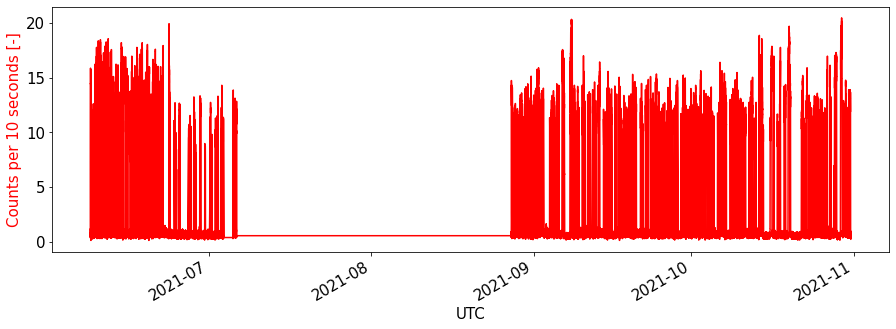

In [128]:
plt.figure(figsize=(15,5))
matplotlib.rcParams.update({'font.size': 15})

#rc = df.loc[df[0]=='$CANDY']
rc.reset_index(drop=True, inplace=True)

#rc['sum'] = rc[range(7,255)].sum(axis=1)
rc['sum'] = rc[range(10,255)].sum(axis=1)

rc['time'] = pd.to_datetime(pd.to_datetime(rc['run']) + pd.to_timedelta(rc[2], unit='s'))
rc.set_index('time', drop=False, inplace=True)

rc[9:258].apply(pd.to_numeric, errors='coerce')

WINDOW = 30
rc['sum'] = rc['sum'].rolling(WINDOW).mean()

rc['sum'].plot(color='r')
#plt.ylim([0,20])
plt.xlabel('UTC')
plt.ylabel('Counts per 10 seconds [-]', color='red')

# Load and plot telemetry data

In [100]:
#ftt = glob.iglob(fto+"/*/*.csv") # generator, search immediate subdirectories 
ftt = glob.iglob(fto+"/*.csv") # generator, search immediate subdirectories 
tele = pd.DataFrame()
for f in ftt:
    #print(f)
    tele = pd.concat([tele, pd.read_csv(f)])
#tele

Text(0, 0.5, 'Altitude a.s.l. [ft]')

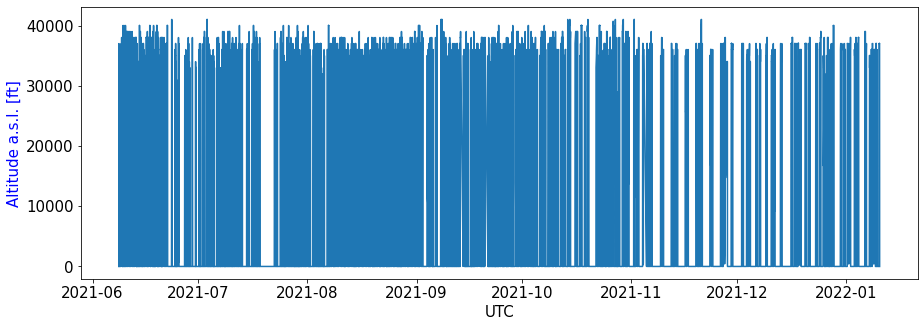

In [102]:
plt.figure(figsize=(15,5))

tele['time'] = pd.to_datetime(tele['UTC'], format='%Y-%m-%dT%H:%M:%SZ')
tele.set_index('time', inplace=True)
tele.sort_index(inplace=True)
plt.plot(tele['Altitude'])
plt.xlabel('UTC')
plt.ylabel('Altitude a.s.l. [ft]', color='blue')

# Combine AIRDOS and telemetry data

Text(0, 0.5, 'Counts per 10 seconds [-]')

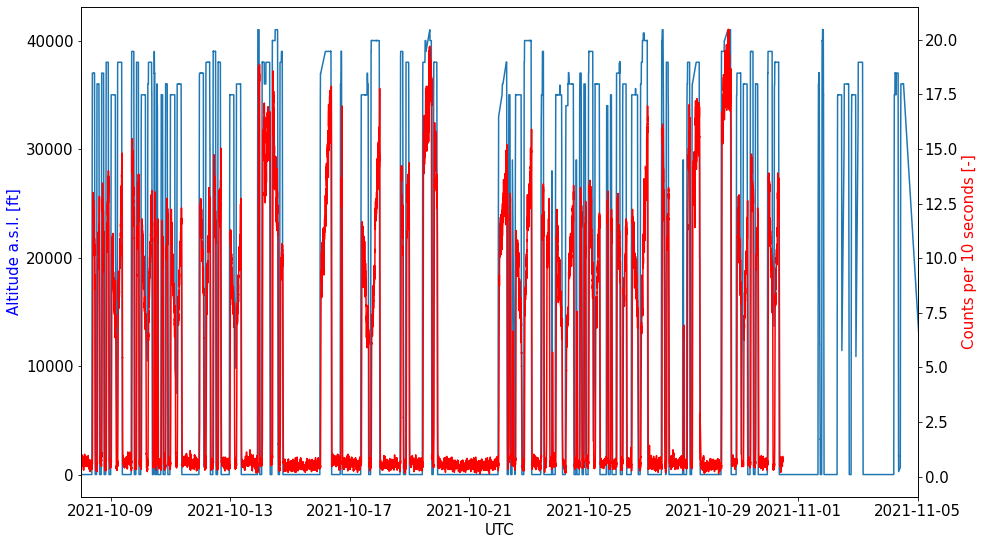

In [130]:
plt.figure(figsize=(15,10))

plt.plot(tele['Altitude'])
# Set limits of plot for magnification
#plt.xlim(pd.Timestamp('2019-09-03'),pd.Timestamp('2019-09-7'))
#plt.xlim(pd.Timestamp('2021-06-8'),pd.Timestamp('2021-06-12'))
plt.xlim(pd.Timestamp('2021-10-8'),pd.Timestamp('2021-11-5')) # SWA last measurement
#plt.xlim(pd.Timestamp('2021-9-15'),pd.Timestamp('2021-9-28')) # SWB last measurement
plt.ylabel('Altitude a.s.l. [ft]', color='blue')
plt.xlabel('UTC')

plt.twinx()

rc['sum'].plot(color='r')
plt.ylabel('Counts per 10 seconds [-]', color='red')


# Plot with plotly

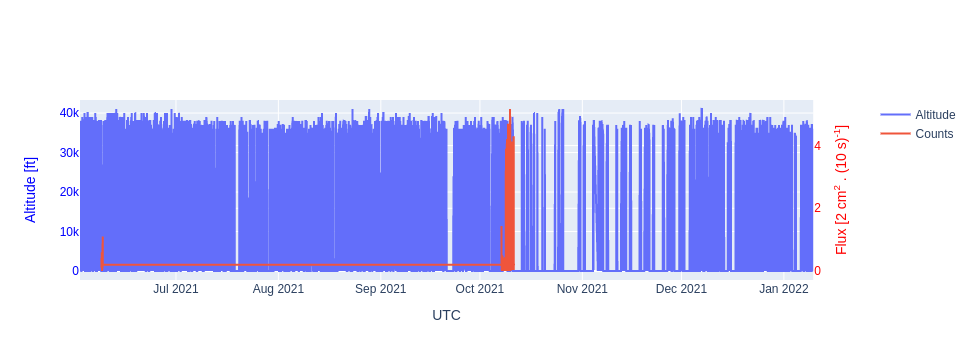

In [228]:
# Create figure with secondary y-axis
fig = make_subplots(specs=[[{"secondary_y": True}]])

# Add traces
fig.add_trace(
    go.Scatter(x=tele.index, y=tele.Altitude, name="Altitude"),
    secondary_y=False,
)

fig.add_trace(
    go.Scatter(x=rc.index, y=rc['sum'], name="Counts"),
    secondary_y=True,
)



# Set x-axis title
fig.update_xaxes(title_text="UTC")

# Set y-axes titles
fig.update_yaxes(title_text="Altitude [ft]", color='blue', secondary_y=False)
fig.update_yaxes(title_text="Flux [2 cm<sup>2</sup> . (10 s)<sup>-1</sup>]", color='red', secondary_y=True)

fig.show()

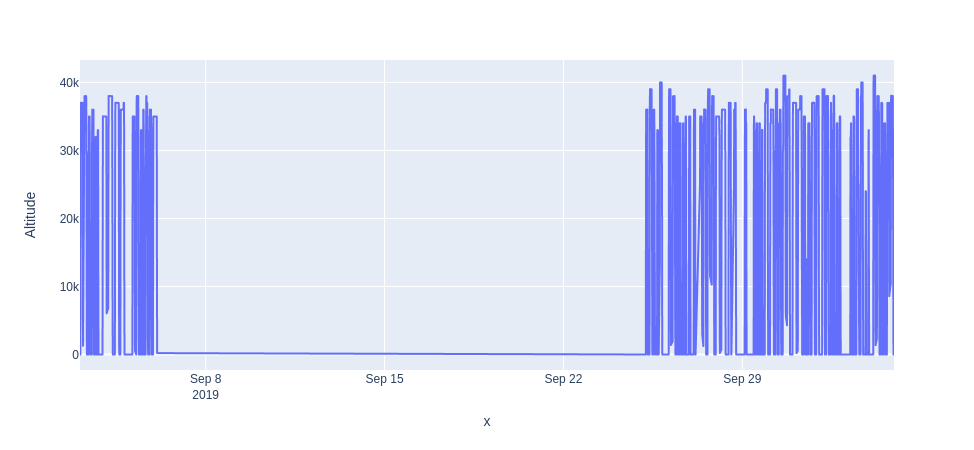

In [128]:
fig = px.line(tele, x=tele.index, y="Altitude")
fig.show()

In [179]:
import ipywidgets as widgets

In [189]:
fto = '/storage/aircraft/airdos/2019/TS/A016/200716-' #  File to Open
ftt = glob.iglob(fto+"/*/*.csv") # generator, search immediate subdirectories 
#tele = pd.DataFrame()
#for f in ftt:
    #print(f)
    #tele = pd.concat([tele, pd.read_csv(f)])


print(ftt)

ble = widgets.DatePicker(
    description='Pick a Date',
    disabled=False
)
display(ble)


<generator object _iglob at 0x7f529c5b1550>


DatePicker(value=None, description='Pick a Date')

In [192]:
print(ble.value)

2020-11-17


Text(0, 0.5, 'Counts per 10 seconds [-]')

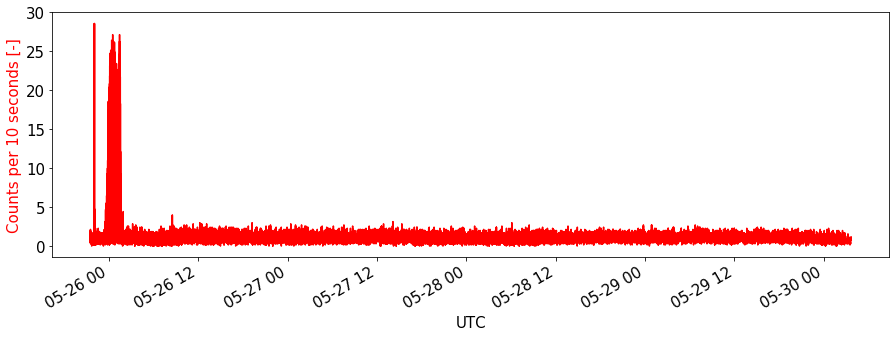

In [56]:
plt.figure(figsize=(15,5))
matplotlib.rcParams.update({'font.size': 15})

#rc = df.loc[df[0]=='$CANDY']
rc.reset_index(drop=True, inplace=True)

rc = rc.apply(pd.to_numeric, errors='coerce')

#rc['sum'] = rc[range(7,255)].sum(axis=1)
rc['sum'] = rc[range(10,255)].sum(axis=1)

rc['time'] = pd.to_datetime(pd.to_datetime(SWITCH_ON_AIRDOS) + pd.to_timedelta(rc[2], unit='s'))
rc = rc.set_index(['time'])

WINDOW = 7
rc['sum'] = rc['sum'].rolling(WINDOW).mean()

rc['sum'].plot(color='r')
#plt.ylim([0,20])
plt.xlabel('UTC')
plt.ylabel('Counts per 10 seconds [-]', color='red')

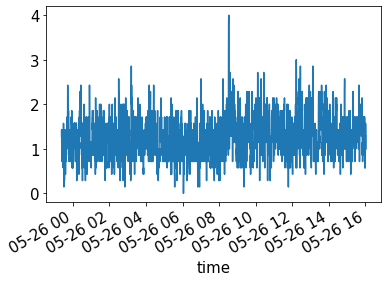

In [58]:
rc['sum'].iloc[:5000].plot()

In [59]:
df

,0,1,2,3,4,5,6,7,8,9,...,248,249,250,251,252,253,254,255,256,257
0,$CANDY,557,6655,24794,0,255.0,1.0,13217.0,7962.0,26.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1,$CANDY,558,6705,24778,2,255.0,0.0,13392.0,7803.0,25.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2,$CANDY,559,6717,24789,2,256.0,0.0,13170.0,8013.0,26.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
3,$CANDY,560,6728,24732,0,255.0,0.0,13526.0,7710.0,32.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
4,$CANDY,561,6740,24739,0,256.0,0.0,13543.0,7696.0,22.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
75743,$CANDY,2673,42948,24801,1,255.0,0.0,13149.0,8018.0,31.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
75744,$CANDY,2674,42964,24848,1,256.0,0.0,12778.0,8346.0,27.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
75745,$CANDY,2675,42980,24756,2,255.0,0.0,13357.0,7866.0,19.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
75746,$CANDY,2676,42996,24793,1,256.0,0.0,13194.0,7992.0,20.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


In [81]:
rc = df.iloc[73400:74100].copy()

In [82]:
rc['sum'] = rc[range(10,255)].sum(axis=1)


Text(0, 0.5, 'Counts per 10 seconds [-]')

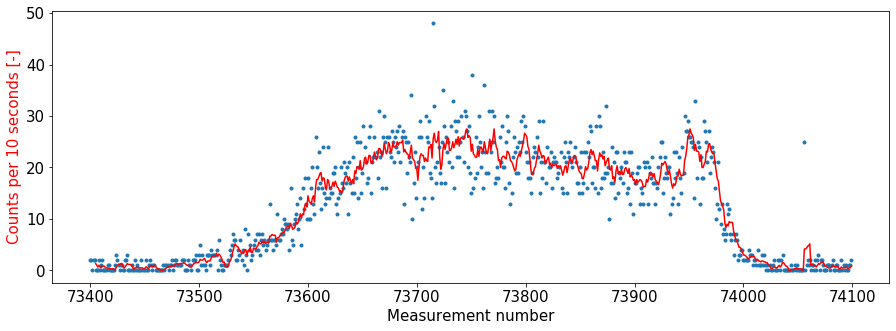

In [87]:
plt.figure(figsize=(15,5))
matplotlib.rcParams.update({'font.size': 15})
rc['sum'].plot(marker='.',ls='')

WINDOW = 6
rc['mean'] = rc['sum'].rolling(WINDOW).mean()

rc['mean'].plot(color='r')
#plt.ylim([0,20])
plt.xlabel('Measurement number')
plt.ylabel('Counts per 10 seconds [-]', color='red')


Text(0, 0.5, 'Counts per 10 seconds [-]')

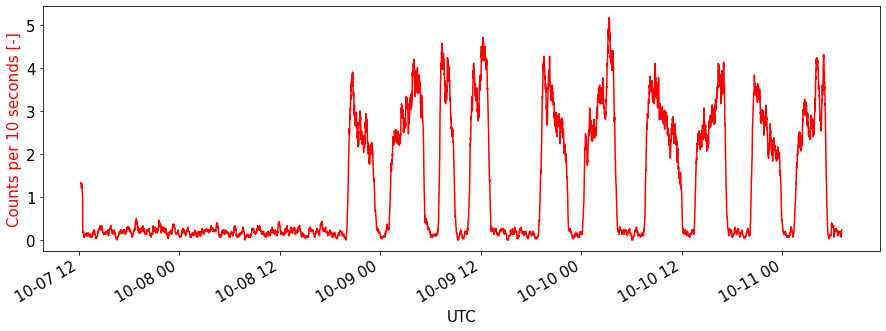

In [286]:
plt.figure(figsize=(15,5))
matplotlib.rcParams.update({'font.size': 15})

#rc = df.loc[df[0]=='$CANDY']
rc.reset_index(drop=True, inplace=True)

#rc['sum'] = rc[range(7,255)].sum(axis=1)
rc['sum'] = rc[range(10,255)].sum(axis=1)

rc[2] = rc[2].apply(pd.to_numeric, errors='coerce')

rc['time'] = pd.to_datetime(pd.to_datetime(rc['run']) + pd.to_timedelta(rc[2], unit='s'))
rc.set_index('time', drop=False, inplace=True)

rc[9:258].apply(pd.to_numeric, errors='coerce')

rc = rc['2021-9-28':]


WINDOW = 30
rc['sum'] = rc['sum'].rolling(WINDOW).mean()
rc['diff'] = rc['sum'].diff()

rc['sum'].plot(color='r')
#plt.twinx()
#rc['sum'].loc[rc['sum']>3.2].plot(color='b')
#plt.ylim([0,20])
plt.xlabel('UTC')
plt.ylabel('Counts per 10 seconds [-]', color='red')

In [282]:
xc = rc['2021-9-28':]


WINDOW = 30
xc['sum'] = xc['sum'].rolling(WINDOW).mean()
xc['diff'] = xc['sum'].diff()
xc['flight'] = xc.loc[xc['sum']>3.2,'sum']
xc['flight'] = xc['flight'].fillna(0)

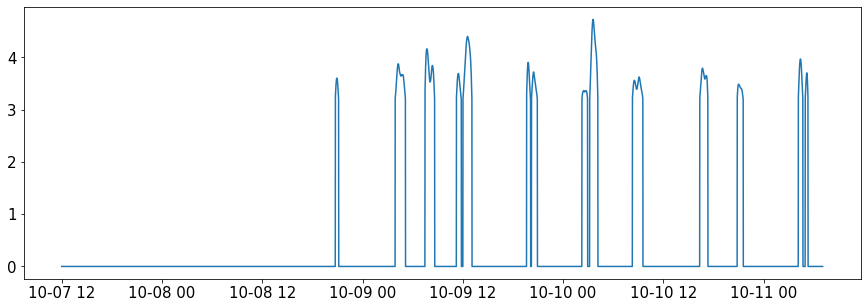

In [283]:
plt.figure(figsize=(15,5))
matplotlib.rcParams.update({'font.size': 15})
plt.plot(xc['flight'])

In [284]:
zc = tele.join(xc)
zc['korelace'] = zc['Altitude']*zc['flight']
zc['korelace'].sum()

1587442.9777777777

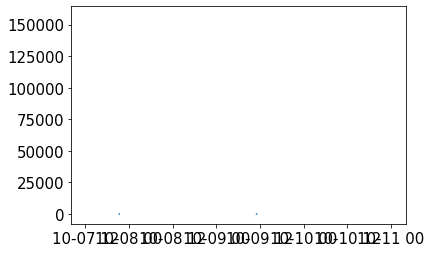

In [268]:
plt.plot(zc['korelace'])


,0,1,2,3,4,5,6,7,8,9,...,252,253,254,255,256,257,run,sum,time,diff
time,,,,,,,,,,,,,,,,,,,,,
2021-10-07 12:00:10,$CANDY,0,10,7064,13103.0,320.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,25513.0,0.0,256.0,2021-10-07 12:00,NaN,2021-10-07 12:00:10,NaN
2021-10-07 12:00:43,$CANDY,1,43,6911,13274.0,283.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,25532.0,0.0,256.0,2021-10-07 12:00,NaN,2021-10-07 12:00:43,NaN
2021-10-07 12:01:15,$CANDY,2,75,6679,13454.0,321.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,25546.0,0.0,256.0,2021-10-07 12:00,NaN,2021-10-07 12:01:15,NaN
2021-10-07 12:01:47,$CANDY,3,107,6678,13428.0,339.0,1.0,0.0,0.0,0.0,...,0.0,0.0,0.0,25552.0,3.0,256.0,2021-10-07 12:00,NaN,2021-10-07 12:01:47,NaN
2021-10-07 12:02:20,$CANDY,4,140,6757,13369.0,331.0,1.0,1.0,0.0,0.0,...,0.0,0.0,0.0,25541.0,2.0,256.0,2021-10-07 12:00,NaN,2021-10-07 12:02:20,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2021-10-11 07:01:49,$CANDY,10015,327709,7619,12662.0,218.0,1.0,0.0,0.0,0.0,...,0.0,0.0,0.0,25498.0,3.0,256.0,2021-10-07 12:00,0.170778,2021-10-11 07:01:49,-0.000926
2021-10-11 07:02:22,$CANDY,10016,327742,7612,12692.0,222.0,2.0,0.0,0.0,1.0,...,0.0,0.0,0.0,25471.0,3.0,256.0,2021-10-07 12:00,0.169889,2021-10-11 07:02:22,-0.000889
2021-10-11 07:02:55,$CANDY,10017,327775,7671,12642.0,226.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,25460.0,1.0,256.0,2021-10-07 12:00,0.169074,2021-10-11 07:02:55,-0.000815
